In [2]:
import pandas as pd
import intake_cs109b_data_mma as cs109b_data
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
from matplotlib_venn import venn2
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode()
import plotly.express as px
from ipywidgets import widgets
import plotly.graph_objects as go
from plotly import figure_factory as ff
import numpy as np
import plotly.io as pio
import seaborn as sns

# pio.renderers.keys()
# pio.renderers.default = 'jupyterlab'

import matplotlib.pylab as plt

In [3]:
df = cs109b_data.original_data.read()
df.head()

,Date Reported As Of,PID,Project Name,Description,Category,Borough,Managing Agency,Client Agency,Current Phase,Design Start,Budget Forecast,Latest Budget Changes,Total Budget Changes,Forecast Completion,Latest Schedule Changes,Total Schedule Changes
0,2014-05-01,3,26th Ward Waste Water Treatment Plant Prelimin...,The 26th Ward WWTP is mandated to be upgraded ...,Wastewater Treatment,Brooklyn,DEP,DEP,Design,2013-09-23,1.829810e+08,-1915400.0,-4318643.37,2020-01-14,1.0,270.0
1,2015-02-01,3,26th Ward Waste Water Treatment Plant Prelimin...,The 26th Ward WWTP is mandated to be upgraded ...,Wastewater Treatment,Brooklyn,DEP,DEP,Construction Procurement,2013-09-23,1.687518e+08,-14229191.0,-4318643.37,2020-07-19,187.0,270.0
2,2015-08-01,3,26th Ward Waste Water Treatment Plant Prelimin...,The 26th Ward WWTP is mandated to be upgraded ...,Wastewater Treatment,Brooklyn,DEP,DEP,Construction Procurement,2013-09-23,1.655324e+08,-3219322.0,-4318643.37,2020-08-08,20.0,270.0
3,2016-01-01,3,26th Ward Waste Water Treatment Plant Prelimin...,The 26th Ward WWTP is mandated to be upgraded ...,Wastewater Treatment,Brooklyn,DEP,DEP,Construction,2013-09-23,1.692764e+08,3743944.0,-4318643.37,2020-04-01,-129.0,270.0
4,2016-06-01,3,26th Ward Waste Water Treatment Plant Prelimin...,The 26th Ward WWTP is mandated to be upgraded ...,Wastewater Treatment,Brooklyn,DEP,DEP,Construction,2013-09-23,1.692764e+08,2.0,-4318643.37,2020-04-13,12.0,270.0


In [4]:
df.groupby("PID")["Latest Budget Changes"].transform("count")

0       13
1       13
2       13
3       13
4       13
        ..
2254     0
2255     0
2256     0
2257     0
2258     0
Name: Latest Budget Changes, Length: 2259, dtype: int64

In [4]:
#assume data is sorted by date


df_unique = df.copy()
df_unique["num_budget_changes"] = df_unique.groupby("PID")["Latest Budget Changes"].transform("count")
df_unique["num_schedule_changes"] = df_unique.groupby("PID")["Latest Schedule Changes"].transform("count")
df_unique["Latest Budget Changes"] = df_unique["Latest Budget Changes"].fillna(0)

#some projects has latest budget changes as first row so need to calculate the original budget
df_unique = df_unique.eval("budget_original = `Latest Budget Changes` + `Budget Forecast`").eval("schedule_original= @pd.to_timedelta(`Latest Schedule Changes`, unit='days') + `Forecast Completion`").drop_duplicates("PID").drop(columns = ["Latest Budget Changes","Latest Schedule Changes"])
df_unique = df_unique.eval("budget_actual = budget_original + `Total Budget Changes`").eval("schedule_actual= schedule_original + @pd.to_timedelta(`Total Schedule Changes`, unit='days')")
df_unique

,Date Reported As Of,PID,Project Name,Description,Category,Borough,Managing Agency,Client Agency,Current Phase,Design Start,Budget Forecast,Total Budget Changes,Forecast Completion,Total Schedule Changes,num_budget_changes,num_schedule_changes,budget_original,schedule_original,budget_actual,schedule_actual
0,2014-05-01,3,26th Ward Waste Water Treatment Plant Prelimin...,The 26th Ward WWTP is mandated to be upgraded ...,Wastewater Treatment,Brooklyn,DEP,DEP,Design,2013-09-23,182980960.0,-4318643.37,2020-01-14,270.0,13,13,181065560.0,2020-01-15,1.767469e+08,2020-10-11
13,2013-09-01,7,Bowery Bay Waste Water Treatment Plant Main Se...,The existing Main Sewage Pumps have deteriorat...,Wastewater Treatment,Queens,DEP,DEP,Design,2013-05-01,53493000.0,15305457.00,2018-03-31,685.0,14,14,53493000.0,NaT,6.879846e+07,NaT
28,2013-09-01,18,Croton Falls Pumping Station Construction,This project will construct a new pumping stat...,Water Supply,Carmel,DEP,DEP,Construction,2003-08-22,66616435.0,1255175.02,2017-05-31,1014.0,14,14,66616435.0,NaT,6.787161e+07,NaT
43,2013-09-01,25,Gowanus Facilities Upgrade,This project will rehabilite the existing Flus...,Wastewater Treatment,Brooklyn,DEP,DEP,Construction,2001-11-01,198134067.0,25233101.11,2014-08-05,1974.0,14,14,198134067.0,NaT,2.233672e+08,NaT
58,2013-09-01,34,Jamaica Waste Water Treatment Plant Upgrades,This project will replace the Jamaica Waste Wa...,Wastewater Treatment,Queens,DEP,DEP,Construction,1996-05-01,463790739.0,-14632471.11,2014-07-01,2009.0,14,14,463790739.0,NaT,4.491583e+08,NaT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2254,2019-09-01,1010,PRIOR NOTICE SIDEWALKS - BROOKLYN,PRIOR NOTICE SIDEWALKS - BROOKLYN,Streets and Roadways,NaN,DDC,DOT,Construction,2015-08-06,29427000.0,NaN,2020-05-13,NaN,0,0,29427000.0,NaT,NaN,NaT
2255,2019-09-01,1011,"RECONSTRUCTION OF ROSEDALE AREA, PHASE 2",NaN,Streets and Roadways,NaN,DDC,DOT,Design,2018-06-07,39360000.0,NaN,2024-08-14,NaN,0,0,39360000.0,NaT,NaN,NaT
2256,2019-09-01,1012,"RECONSTRUCTION OF FRONT STREET, MANHATTAN","Reconstruction of Front Street, Manhattan",Streets and Roadways,NaN,DDC,DOT,Construction Procurement,2015-07-31,27356000.0,NaN,2022-06-16,NaN,0,0,27356000.0,NaT,NaN,NaT
2257,2019-09-01,1013,"GRAND CONCOURSE, PHASE 5",THE FIFTH PHASE OF THE RECONSTRUCTION OF THE G...,Streets and Roadways,NaN,DDC,DOT,Design,2019-09-16,78921000.0,NaN,2025-09-13,NaN,0,0,78921000.0,NaT,NaN,NaT


Not all of projects start with design phase

In [5]:
df_unique.query("`Current Phase` == 'Design'").PID.nunique()

229

- Absolute percentage error: |Forecast − Actual|/Actual
- Relative percentage error: (referred to as cost escalation in project estimation literature): |Forecast − Actual|/Forecast:
- Ratios: Forecast/Actual or Actual/Forecast Difference: Actual − Forecast
- Days delayed (only the positive differences) Absolute error: |Forecast − Actual| Squared error: (Forecast − Actual)2

## Calculating metrics

In [6]:
df_unique = df_unique.eval('budget_abs_per_error = abs(budget_original - budget_actual)/budget_actual')\
            .eval('budget_rel_per_error = abs(budget_original - budget_actual)/budget_original')\
            .eval('budget_ratios = budget_actual/budget_original')\
            .eval('days_changed_in_schedule = schedule_actual - schedule_original')
df_unique

,Date Reported As Of,PID,Project Name,Description,Category,Borough,Managing Agency,Client Agency,Current Phase,Design Start,...,num_budget_changes,num_schedule_changes,budget_original,schedule_original,budget_actual,schedule_actual,budget_abs_per_error,budget_rel_per_error,budget_ratios,days_changed_in_schedule
0,2014-05-01,3,26th Ward Waste Water Treatment Plant Prelimin...,The 26th Ward WWTP is mandated to be upgraded ...,Wastewater Treatment,Brooklyn,DEP,DEP,Design,2013-09-23,...,13,13,181065560.0,2020-01-15,1.767469e+08,2020-10-11,0.024434,0.023851,0.976149,270 days
13,2013-09-01,7,Bowery Bay Waste Water Treatment Plant Main Se...,The existing Main Sewage Pumps have deteriorat...,Wastewater Treatment,Queens,DEP,DEP,Design,2013-05-01,...,14,14,53493000.0,NaT,6.879846e+07,NaT,0.222468,0.286121,1.286121,NaT
28,2013-09-01,18,Croton Falls Pumping Station Construction,This project will construct a new pumping stat...,Water Supply,Carmel,DEP,DEP,Construction,2003-08-22,...,14,14,66616435.0,NaT,6.787161e+07,NaT,0.018493,0.018842,1.018842,NaT
43,2013-09-01,25,Gowanus Facilities Upgrade,This project will rehabilite the existing Flus...,Wastewater Treatment,Brooklyn,DEP,DEP,Construction,2001-11-01,...,14,14,198134067.0,NaT,2.233672e+08,NaT,0.112967,0.127354,1.127354,NaT
58,2013-09-01,34,Jamaica Waste Water Treatment Plant Upgrades,This project will replace the Jamaica Waste Wa...,Wastewater Treatment,Queens,DEP,DEP,Construction,1996-05-01,...,14,14,463790739.0,NaT,4.491583e+08,NaT,0.032578,0.031550,0.968450,NaT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2254,2019-09-01,1010,PRIOR NOTICE SIDEWALKS - BROOKLYN,PRIOR NOTICE SIDEWALKS - BROOKLYN,Streets and Roadways,NaN,DDC,DOT,Construction,2015-08-06,...,0,0,29427000.0,NaT,NaN,NaT,NaN,NaN,NaN,NaT
2255,2019-09-01,1011,"RECONSTRUCTION OF ROSEDALE AREA, PHASE 2",NaN,Streets and Roadways,NaN,DDC,DOT,Design,2018-06-07,...,0,0,39360000.0,NaT,NaN,NaT,NaN,NaN,NaN,NaT
2256,2019-09-01,1012,"RECONSTRUCTION OF FRONT STREET, MANHATTAN","Reconstruction of Front Street, Manhattan",Streets and Roadways,NaN,DDC,DOT,Construction Procurement,2015-07-31,...,0,0,27356000.0,NaT,NaN,NaT,NaN,NaN,NaN,NaT
2257,2019-09-01,1013,"GRAND CONCOURSE, PHASE 5",THE FIFTH PHASE OF THE RECONSTRUCTION OF THE G...,Streets and Roadways,NaN,DDC,DOT,Design,2019-09-16,...,0,0,78921000.0,NaT,NaN,NaT,NaN,NaN,NaN,NaT


In [7]:
(df_unique["Total Schedule Changes"] - df_unique["days_changed_in_schedule"].dt.days)[(df_unique["Total Schedule Changes"] - df_unique["days_changed_in_schedule"].dt.days).notnull()].sum()

0.0

In [8]:
df_unique.PID.nunique()

378

In [9]:
df.PID.nunique()

378

In [10]:
df.Category.nunique()

22

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2259 entries, 0 to 2258
Data columns (total 16 columns):
Date Reported As Of        2259 non-null datetime64[ns]
PID                        2259 non-null int64
Project Name               2259 non-null object
Description                2150 non-null object
Category                   2259 non-null object
Borough                    1634 non-null object
Managing Agency            2259 non-null object
Client Agency              1644 non-null object
Current Phase              2154 non-null object
Design Start               2095 non-null datetime64[ns]
Budget Forecast            2153 non-null float64
Latest Budget Changes      1881 non-null float64
Total Budget Changes       2194 non-null float64
Forecast Completion        2137 non-null datetime64[ns]
Latest Schedule Changes    1866 non-null float64
Total Schedule Changes     2186 non-null float64
dtypes: datetime64[ns](3), float64(5), int64(1), object(7)
memory usage: 282.5+ KB


In [12]:
df.describe()

,PID,Budget Forecast,Latest Budget Changes,Total Budget Changes,Latest Schedule Changes,Total Schedule Changes
count,2259.000000,2.153000e+03,1.881000e+03,2.194000e+03,1866.000000,2186.000000
mean,487.699867,1.456504e+08,2.342525e+06,1.838732e+07,74.543944,669.718207
std,258.005332,3.241323e+08,3.387314e+07,7.440035e+07,1115.490817,718.792415
min,3.000000,-4.102606e+06,-3.129920e+08,-2.919002e+08,-32620.000000,-1462.000000
25%,314.000000,3.913500e+07,-1.750000e+05,0.000000e+00,0.000000,77.000000
50%,504.000000,6.078000e+07,1.300000e+04,5.827000e+06,0.000000,621.000000
75%,668.000000,1.103256e+08,2.100000e+06,2.990000e+07,149.500000,1097.000000
max,1014.000000,2.631661e+09,7.288500e+08,8.078026e+08,32872.000000,3253.000000


In [13]:
df.columns

Index(['Date Reported As Of', 'PID', 'Project Name', 'Description', 'Category',
       'Borough', 'Managing Agency', 'Client Agency', 'Current Phase',
       'Design Start', 'Budget Forecast', 'Latest Budget Changes',
       'Total Budget Changes', 'Forecast Completion',
       'Latest Schedule Changes', 'Total Schedule Changes'],
      dtype='object')

In [14]:
profile = ProfileReport(df, title='Pandas Profiling Report', html={'style':{'full_width':True}})

In [15]:
df.drop_duplicates("Project Name").Description.value_counts()

Design and construction of a new school                                                                                                                                                                                                           28
Design and construction of right-of-way green infrastructure in order for the city to comply with NYS DEC consent order which states that NYC must manage 1” of rain on 10% of impervious surfaces by 2030 to reduce combined sewer overflows.     3
Design and construction of an addition to an existing school.                                                                                                                                                                                      3
Gilboa Dam Reconstruction Project includes construction of a new low level outlet (LLO) consisting of 2,000 feet of tunneling , an access shaft, oulet structure and gate valve controls.                                                          1
Install new high lev

## Overview

- Project Name and Description is not a 1 to 1 match, some projects have more than 1 description (?)

- Multiple projects can be designed at the same day (10% of projects overlap)

- 1 Project has project ID but no name

- Reports rise steadily from 2014-2018. More than half of reports are in 2019

- 28 Projects have same description: "Design and construction of a new school". 3 Design and construction of an addition to an existing school. 3 Design and construction of right-of-way green infrastructure in order for the city to comply with NYS DEC consent order which states that NYC must manage 1” of rain on 10% of impervious surfaces by 2030 to reduce combined sewer overflows. The others have unique descriptions

- Design start looks bimodal, one around 2000 - 2008, other from 2012 - 2020

- Budget forecast varies widely. Most small but a couple of very big ones. One negative budget forecast

- Some outliers need to remove to visualize budget metrics

## Missing
- Don't see any missing patterns in the full data, see some clustering of missing patterns in unique projects
- Should see if there's any missing trends (`df_dummy_unique`)

## Questions
- Why isn't the first phase design for all projects?
- How to find initial budget forecast?
- Should total schedule changes be a percentage?

### To do
- Plot co-occurence matrix of variables
- Plot category
- Plot category vs number of revisions
- Category vs borough


In [16]:
profile.to_widgets()

In [17]:
profile.to_notebook_iframe()

In [18]:
profile.to_file(output_file="Capital_Projects_EDA_An.html")

## Unique, each project one line

In [19]:
unique_profile = ProfileReport(df_unique, title='Unique Projects Profiling Report', html={'style':{'full_width':True}})

In [20]:
unique_profile.to_widgets()

In [21]:
unique_profile.to_notebook_iframe()

In [22]:
df_unique_dummy = pd.get_dummies(df_unique, dummy_na = True)
df_unique_dummy

,Date Reported As Of,PID,Design Start,Budget Forecast,Total Budget Changes,Forecast Completion,Total Schedule Changes,num_budget_changes,num_schedule_changes,budget_original,...,Client Agency_ORR,Client Agency_QL,Client Agency_WWC,Client Agency_nan,Current Phase_Construction,Current Phase_Construction Procurement,Current Phase_Design,Current Phase_IT,Current Phase_Scoping/Planning,Current Phase_nan
0,2014-05-01,3,2013-09-23,182980960.0,-4318643.37,2020-01-14,270.0,13,13,181065560.0,...,0,0,0,0,0,0,1,0,0,0
13,2013-09-01,7,2013-05-01,53493000.0,15305457.00,2018-03-31,685.0,14,14,53493000.0,...,0,0,0,0,0,0,1,0,0,0
28,2013-09-01,18,2003-08-22,66616435.0,1255175.02,2017-05-31,1014.0,14,14,66616435.0,...,0,0,0,0,1,0,0,0,0,0
43,2013-09-01,25,2001-11-01,198134067.0,25233101.11,2014-08-05,1974.0,14,14,198134067.0,...,0,0,0,0,1,0,0,0,0,0
58,2013-09-01,34,1996-05-01,463790739.0,-14632471.11,2014-07-01,2009.0,14,14,463790739.0,...,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2254,2019-09-01,1010,2015-08-06,29427000.0,NaN,2020-05-13,NaN,0,0,29427000.0,...,0,0,0,0,1,0,0,0,0,0
2255,2019-09-01,1011,2018-06-07,39360000.0,NaN,2024-08-14,NaN,0,0,39360000.0,...,0,0,0,0,0,0,1,0,0,0
2256,2019-09-01,1012,2015-07-31,27356000.0,NaN,2022-06-16,NaN,0,0,27356000.0,...,0,0,0,0,0,1,0,0,0,0
2257,2019-09-01,1013,2019-09-16,78921000.0,NaN,2025-09-13,NaN,0,0,78921000.0,...,0,0,0,0,0,0,1,0,0,0


In [23]:
df_unique_no_outliers = df_unique.query("budget_ratios < 40")

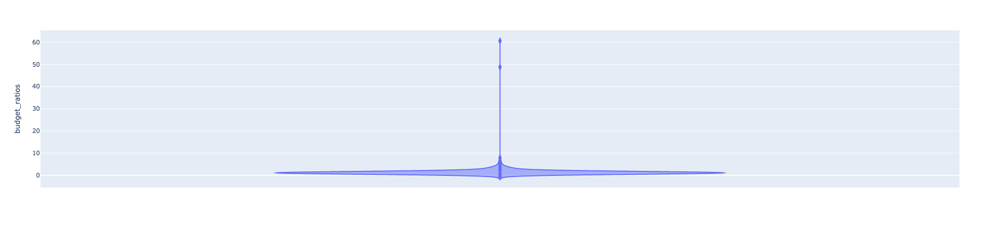

In [24]:
px.violin(df_unique, y="budget_ratios")

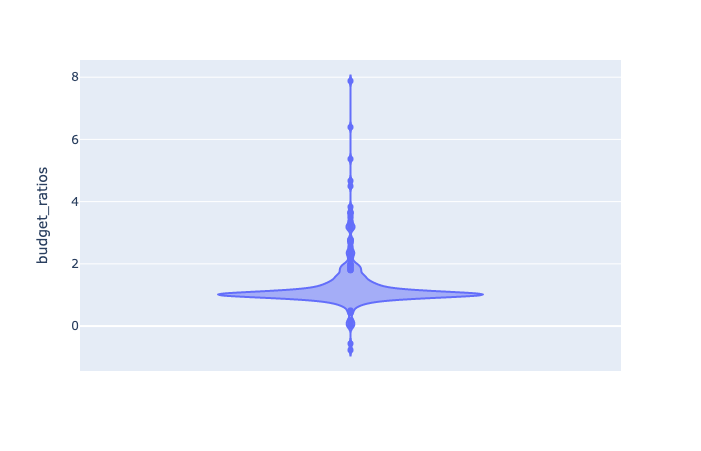

In [25]:
px.violin(df_unique_no_outliers, y="budget_ratios")

In [61]:
np.sum(df.groupby('PID').agg({'Latest Budget Changes': 'first'}).isnull())

Latest Budget Changes    64
dtype: int64

In [60]:
df.drop_duplicates("PID")["Latest Budget Changes"].count()

91

In [26]:
profile_unique_no_outliers = ProfileReport(df_unique_no_outliers, title='Unique no outliers Profiling Report', html={'style':{'full_width':True}})

In [27]:
profile_unique_no_outliers.to_widgets()

In [28]:
profile_unique_no_outliers.to_notebook_iframe()

---
# Own Analysis

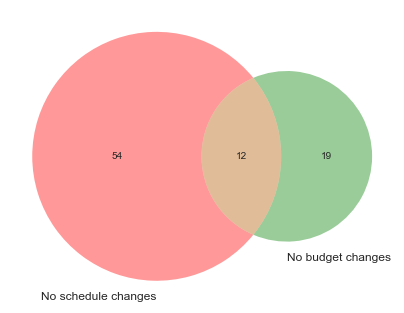

In [29]:
venn2([set(df.query("`Total Schedule Changes` == 0").PID.unique()), set(df.query("`Total Budget Changes` == 0").PID.unique())], set_labels= ("No schedule changes", "No budget changes"));


## Visualizing stationary attributes

In [30]:
df_unique_melted = df_unique.melt(id_vars=["PID", "Category", "Borough", "Total Schedule Changes"], value_vars=["budget_abs_per_error", 'budget_rel_per_error', 'budget_ratios'], var_name="metric", value_name="metric_value")

### Budget

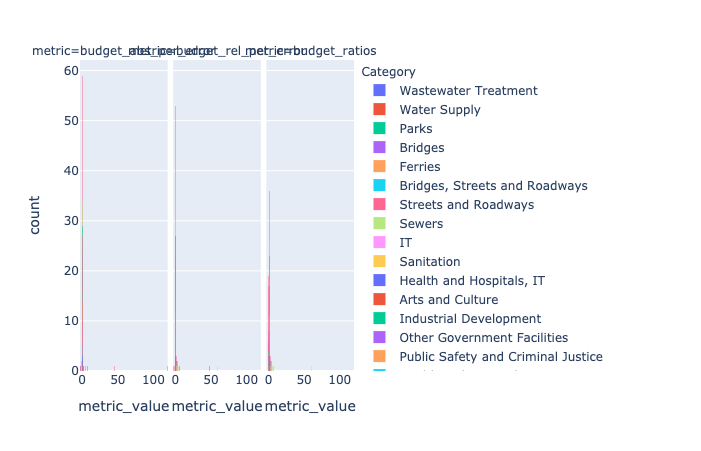

In [31]:
px.histogram(df_unique_melted,x="metric_value", facet_col="metric", color="Category", barmode="overlay" )

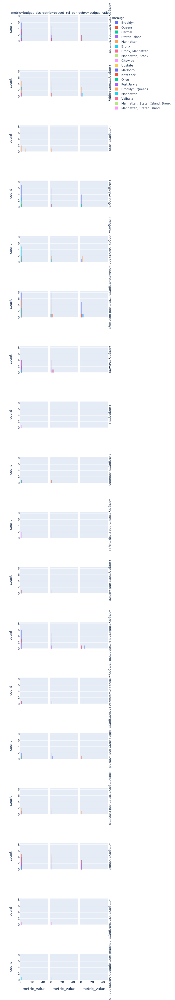

In [32]:
#not visualizing nans
px.histogram(df_unique_melted.dropna(),x="metric_value", facet_col="metric", facet_row= "Category", color="Borough", barmode="overlay" , height=4000)

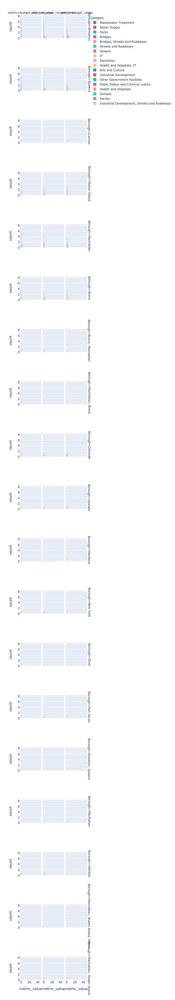

In [33]:
px.histogram(df_unique_melted.dropna(),x="metric_value", facet_col="metric", facet_row= "Borough", color="Category", barmode="overlay" , height=4000)

### Schedule

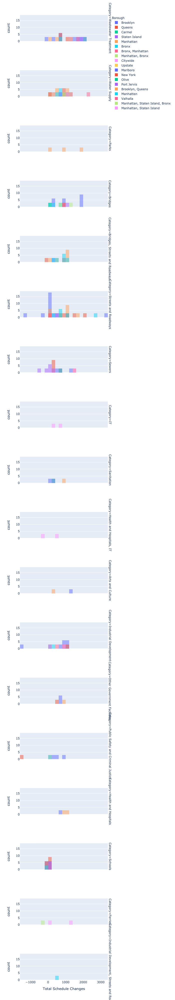

In [34]:
px.histogram(df_unique_melted.dropna(),x="Total Schedule Changes",  facet_row= "Category", color="Borough", barmode="overlay" , height=4000)

In [36]:
df.columns

Index(['Date Reported As Of', 'PID', 'Project Name', 'Description', 'Category',
       'Borough', 'Managing Agency', 'Client Agency', 'Current Phase',
       'Design Start', 'Budget Forecast', 'Latest Budget Changes',
       'Total Budget Changes', 'Forecast Completion',
       'Latest Schedule Changes', 'Total Schedule Changes'],
      dtype='object')

## Change in budget through time

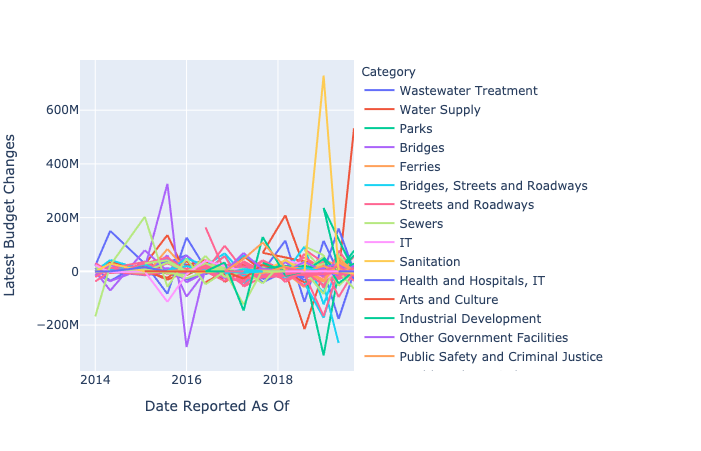

In [52]:
px.line(df, x='Date Reported As Of', y="Latest Budget Changes", color = "Category", hover_name="PID")

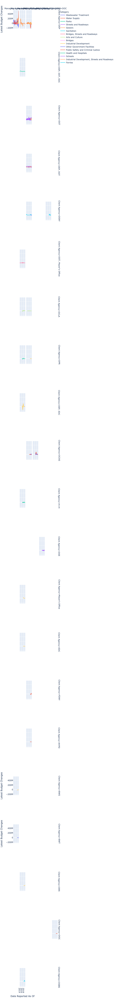

In [49]:
px.line(df.dropna(), x='Date Reported As Of', facet_col ='Managing Agency', facet_row='Client Agency',  y="Latest Budget Changes", color = "Category", height=6000)

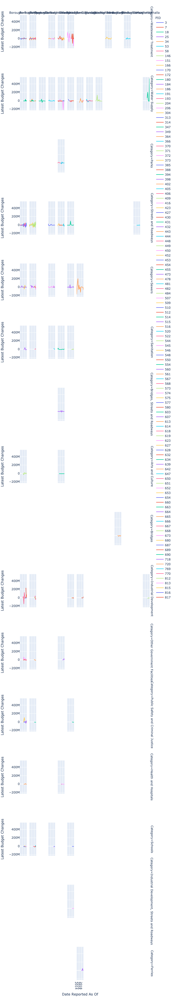

In [44]:
px.line(df.dropna(), x='Date Reported As Of', facet_row="Category", facet_col="Borough", y="Latest Budget Changes", color = "PID", height=4000)

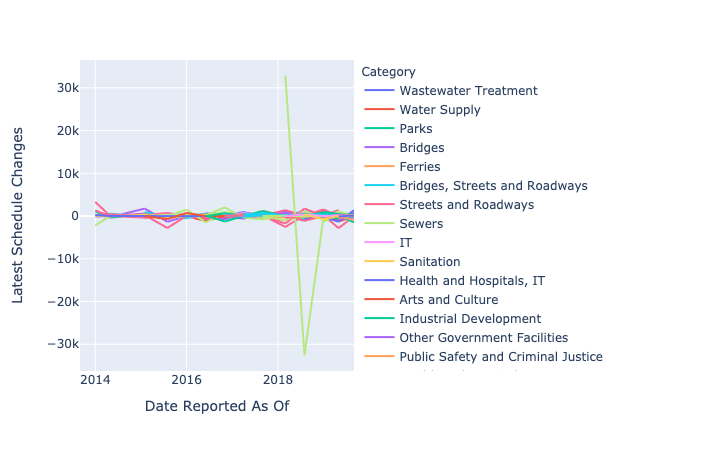

In [58]:
px.line(df, x='Date Reported As Of', y="Latest Schedule Changes", color = "Category", hover_name="PID")

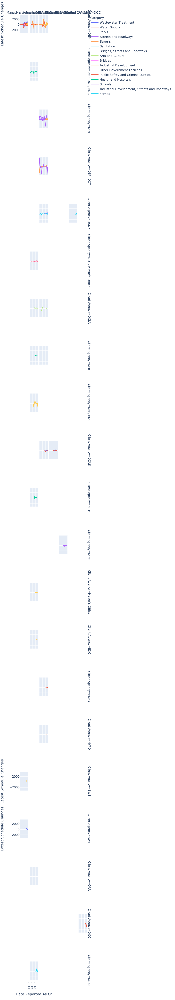

In [55]:
px.line(df.dropna(), x='Date Reported As Of', facet_row="Client Agency",  facet_col="Managing Agency", y="Latest Schedule Changes", color = "Category", height=4000)

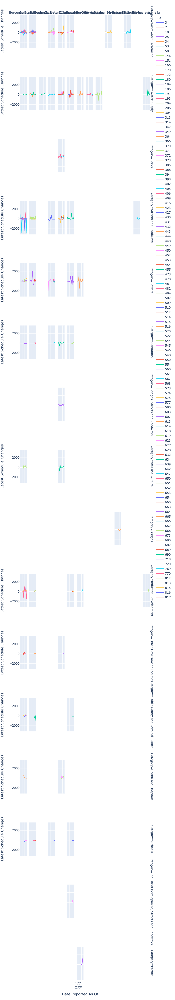

In [53]:
px.line(df.dropna(), x='Date Reported As Of', facet_row="Category", facet_col="Borough", y="Latest Schedule Changes", color = "PID", height=4000)

Explore metrics
- Absolute percentage error: |Forecast − Actual|/Actual
- Relative percentage error: (referred to as cost escalation in project estimation literature): |Forecast − Actual|/Forecast:
- Ratios: Forecast/Actual or Actual/Forecast Difference: Actual − Forecast
- Days delayed (only the positive differences) Absolute error: |Forecast − Actual| Squared error: (Forecast − Actual)2

## Ideas: 
- Encode a "role" of each people working on the project (people who they work with, what projects do they work on etc) in a latent representation/ graph
- Clustering the raw features or use latent representation to find "reference" class
- 1 Model text, one model organizational structure (graph), one model RNN of sequence of events